<a href="https://colab.research.google.com/github/lblogan14/master_tensorflow_keras/blob/master/ch12_transfer_learning.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

**Transfer learning** means that you take a pre-trained model trained to
predict one kind of class, and then either use it directly or re-train only a small part of it, in
order to predict another kind of class.

###Code Prerequisite

In [23]:
import os
import math

import numpy as np
np.random.seed(123)
print("NumPy:{}".format(np.__version__))

import matplotlib as mpl
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from matplotlib.pylab import rcParams
rcParams['figure.figsize']=15,10
print("Matplotlib:{}".format(mpl.__version__))

import tensorflow as tf
tf.set_random_seed(123)
print("TensorFlow:{}".format(tf.__version__))
from tensorflow.contrib import slim

import keras
print("Keras:{}".format(keras.__version__))

NumPy:1.14.6
Matplotlib:2.1.2
TensorFlow:1.12.0
Keras:2.2.4


Using TensorFlow backend.


In [2]:
from google.colab import drive
drive.mount('/content/drive')
%cd /content/drive/My' 'Drive/Colab' 'Notebooks/Mastering_TensorFlow/data

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3Aietf%3Awg%3Aoauth%3A2.0%3Aoob&scope=email%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdocs.test%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdrive%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdrive.photos.readonly%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fpeopleapi.readonly&response_type=code

Enter your authorization code:
··········
Mounted at /content/drive
/content/drive/My Drive/Colab Notebooks/Mastering_TensorFlow/data


In [3]:
!pip3 install imageio
DATASETSLIB_HOME = os.path.expanduser('~/dl-ts/datasetslib')
import sys
if not DATASETSLIB_HOME in sys.path:
    sys.path.append(DATASETSLIB_HOME)
%reload_ext autoreload
%autoreload 2
import datasetslib

from datasetslib import util as dsu
from datasetslib import nputil
datasetslib.datasets_root = os.path.join(os.path.expanduser('~'),'datasets')
models_root = os.path.join(os.path.expanduser('~'),'models')

    100% |████████████████████████████████| 3.3MB 10.3MB/s 
  Running setup.py bdist_wheel for imageio ... - \ | / done
  Stored in directory: /root/.cache/pip/wheels/e0/43/31/605de9372ceaf657f152d3d5e82f42cf265d81db8bbe63cde1
Successfully built imageio


#ImageNet dataset
The custom function to download the ImageNet labels from Google:

In [0]:
def build_id2label(self):
  base_url = 'https://raw.githubusercontent.com/tensorflow/models/master/research/inception/inception/data/'
  synset_url = '{}/imagenet_lsvrc_2015_synsets.txt'.format(base_url)
  synset_to_human_url = '{}/imagenet_metadata.txt'.format(base_url)
  
  filename, _ = urllib.request.urlretrieve(synset_url)
  synset_list = [s.strip() for s in open(filename).readlines()]
  num_synsets_in_ilsvrc = len(synset_list)
  assert num_synsets_in_ilsvrc == 1000
  
  filename, _ = urlib.request.urlretrieve(synset_to_human_url)
  synset_to_human_list = open(filename).readlines()
  num_synsets_in_all_imagenet = len(synset_to_human_list)
  assert num_synsets_in_all_imagenet = 21842
  
  synset2name = {}
  for s in synset_to_human_list:
    parts = s.strip().split('\t')
    assert len(parts) == 2
    synset = parts[0]
    name = parts[1]
    synset2name[synset] = name

  if self.n_classes == 1001:
    id2label={0:'empty'}
    id=1
  else:
    id2label = {}
    id=0
  
  for synset in synset_list:
    label = synset2name[synset]
    id2label[id] = label
    id += 1
  return id2label

## Load ImageNet dataset for labels,

In [0]:
# load imagenet dataset for labels
from datasetslib.imagenet import imageNet
inet = imageNet()
inet.load_data(n_classes=1000)
# n_classes = 1001 for Inception models and 1000 for VGG models

#Retraining or fune-tuning models
Models trained on large and diverse datasets like ImageNet are able to detect and capture
some of the universal features such as curves, edges, and shapes. Some of these features are
easily applicable to other kinds of datasets. Thus, in transfer learning we take such
universal models and use some of the following techniques to fine-tune or retrain them to
our datasets:
* **Repeal and replace the last layer**: remove the last layer and add the new classification layer that matches our dataset. Generally, this technique is used when the new dataset is almost similar
to the one that the model was trained on, thus needing only the last layer to be
retrained.
* **Freeze the first few layers**: freeze the first few
layers such that the weights of only the last unfrozen layers get updated with the
new dataset. Generally, this technique is used when the
new dataset is not very similar to the one that the model was trained on, thus
requiring more than just the last layers to be trained.
* **Tune the hyperparameters**: also tune the hyperparameters before
retraining, such as changing the learning rate or trying a different loss function or
different optimizer.

#COCO animals dataset and preprocessing images
The COCO animals dataset has 800
training images and 200 test images of 8 classes of animals: bear, bird, cat, dog, giraffe,
horse, sheep, and zebra.

For the **VGG** model, the image size is 224x224 and the proprocessing steps are as follows:
1. Images are resized to 224x224 with a function similar to the `tf.image.resize_image_with_crop_or_pad` function from TensorFlow:

    
    def resize_image(self, in_image:PIL.Image, new_width, new_height, crop_or_pad=True):
        img = in_image
        if crop_or_pad:
            half_width = img.size[0] // 2
           half_height = img.size[1] // 2
           half_new_width = new_width // 2
           half_new_height = new_height // 2
           img = img.crop((half_width - half_new_width,
                           half_height - half_new_height,
                           half_width + half_new_width,
                           half_height + half_new_height))
        img = img.resize(size=(new_width, new_height))
    
        return img

2. After resizing, convert the image from PIL.Image to NumPy Array and check if
the image has depth channels, as some of the images in the dataset
are only grayscale.


    img = self.pil_to_nparray(img)
    if len(img.shape)==2:
        # greyscale or no channels then add three channels
        h=img.shape[0]
        w=img.shape[1]
        img = np.dstack([img]*3)
        
3. Subtract the VGG dataset means from the image to center the data. The
reason we center the data for our new training images is so that the features have
a similar range as the initial data that was used to rain the model. By making
features in the similar range, we make sure that the gradients during retraining
do not become too high or too low. Also by centering the data, the learning
process becomes faster because gradients become uniform for each channel
centered around the zero mean.


    means = np.array([[[123.68, 116.78, 103.94]]]) #shape=[1, 1, 3]
    img = img - means
    
The complete preprocessing function is shown below:


    def preprocess_for_vgg(self,incoming, height, width):
        if isinstance(incoming, six.string_types):
            img = self.load_image(incoming)
        else:
            img=incoming
        img_size = vgg.vgg_16.default_image_size
        height = img_size[0]
        width = img_size[1]
        img = self.resize_image(img,height,width)
        img = self.pil_to_nparray(img)
        if len(img.shape)==2:
            # greyscale or no channels then add three channels
            h=img.shape[0]
            w=img.shape[1]
            img = np.dstack([img]*3)
        means = np.array([[[123.68, 116.78, 103.94]]]) #shape=[1, 1, 3]
        try:
            img = img - means
        except Exception as ex:
            print('Error preprocessing ',incoming)
            print(ex)
        return img

For the **Inception** model, the image size is 299x299 and the preprocessing steps are shown below:
1. Images are resized to 299x299 with a funciton similar to `tf.iamge.resize_image_with_crop_or_pad` function from TensorFlow. Similar to the VGG preprocessing steps
2. The iamge is then scaled to the range (-1, +1) with the following,


    img = ((img/225.0) - 0.5) * 2.0
    
The complete preprocessing shown below:

    def preprocess_for_inception(self,incoming):
        img_size = inception.inception_v3.default_image_size
        height = img_size
        width = img_size
        if isinstance(incoming, six.string_types):
            img = self.load_image(incoming)
        else:
            img=incoming
        img = self.resize_image(img,height,width)
        img = self.pil_to_nparray(img)
        if len(img.shape)==2:
            # greyscale or no channels then add three channels
            h=img.shape[0]
            w=img.shape[1]
           img = np.dstack([img]*3)
        img = ((img/255.0) - 0.5) * 2.0
        return img

##Load COCO animal dataset

In [5]:
# load dataset
from datasetslib.coco import coco_animals

coco = coco_animals()
x_train_files, y_train, x_val_files, x_val = coco.load_data()

Downloading: http://cs231n.stanford.edu/coco-animals.zip
Downloaded : /root/datasets/coco-animals/coco-animals.zip ( 181492696 bytes)


Take one image from each class in the validation set, to make the list, `x_test` and preprocess the images to make the list `images_test`:

In [0]:
x_test = [x_val_files[25*x] for x in range(8)]
images_test = np.array([coco.preprocess_for_vgg(x) for x in x_test])

Use a helper function to display the images and probabilities of the top five classes associated with the image:

In [0]:
# helper function
def disp(images, id2label=None, probs=None, n_top=5, scale=False):
  if scale:
    imgs = np.abs(images + np.array([[[[123.68, 116.78, 103.94]]]])) / 225.0
    # This reverts back to the effect of preprocessing to display the original
    # image instead of the preprocessed image
  else:
    imgs = images
  
  ids = {}
  for j in range(len(images)):
    if scale:
      plt.figure(figsize=(5,5))
      plt.imshow(imgs[j])
      plt.axis('off')
    else:
      plt.imshow(imgs[j].astype(np.uint8))
      plt.axis('off')
    plt.show()
    if probs is not None:
      ids[j] = [i[0] for i in sorted(enumerate(-probs[j]), key=lambda x:x[1])]
      for k in range(n_top):
        id = ids[j][k]
        print('Probability {0:1.2f}% of [{1:}]'.format(100*probs[j,id], id2label[id]))

Look at the test images,

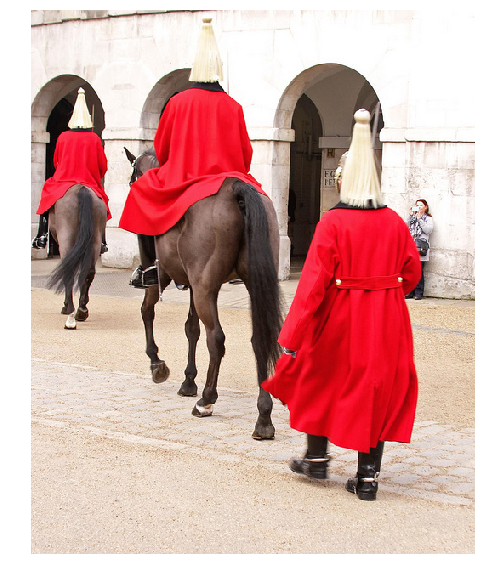

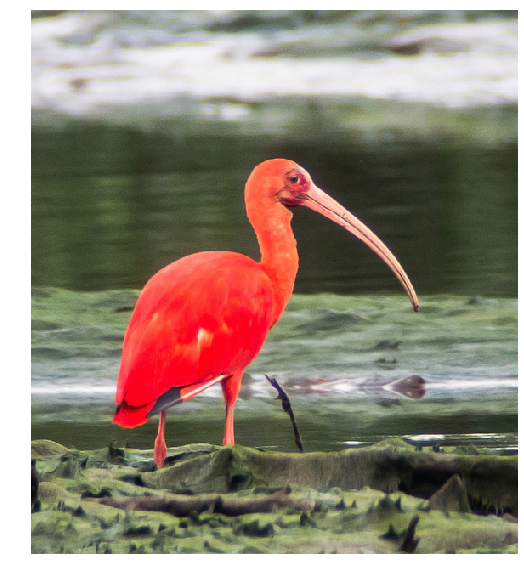

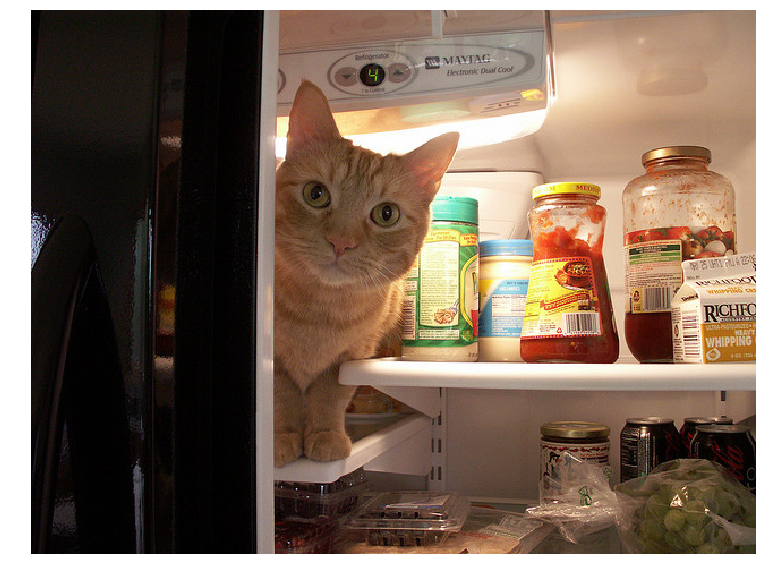

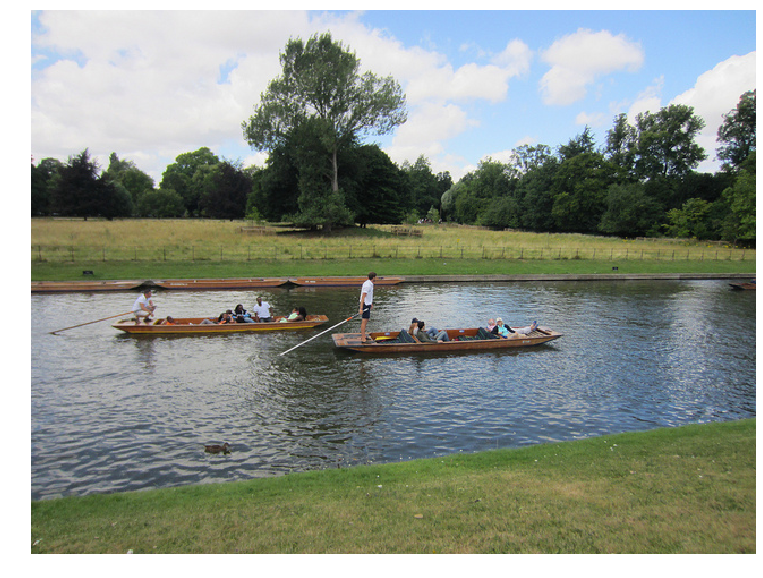

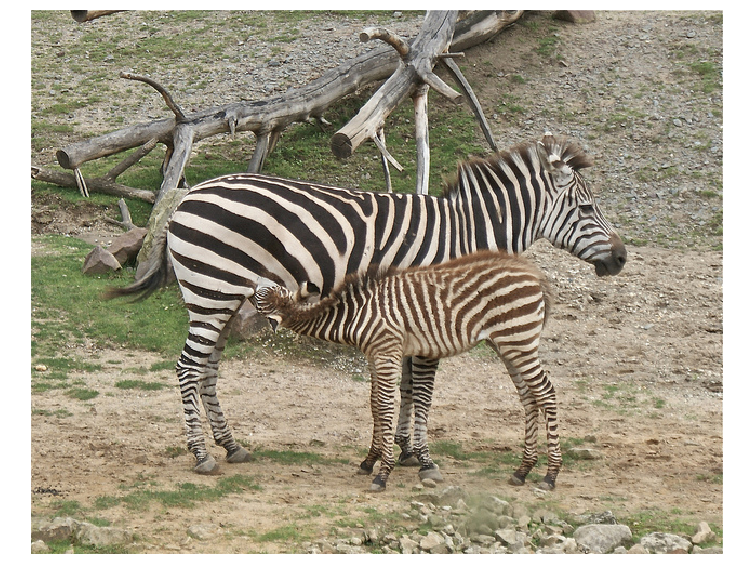

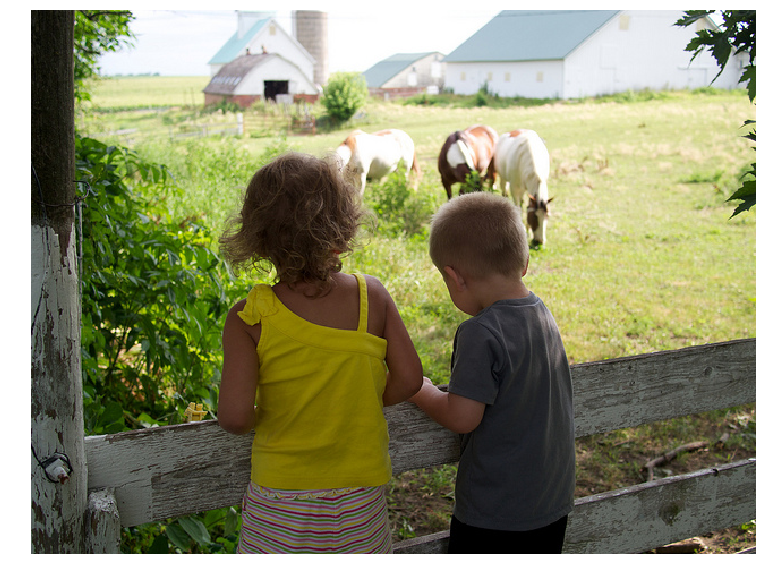

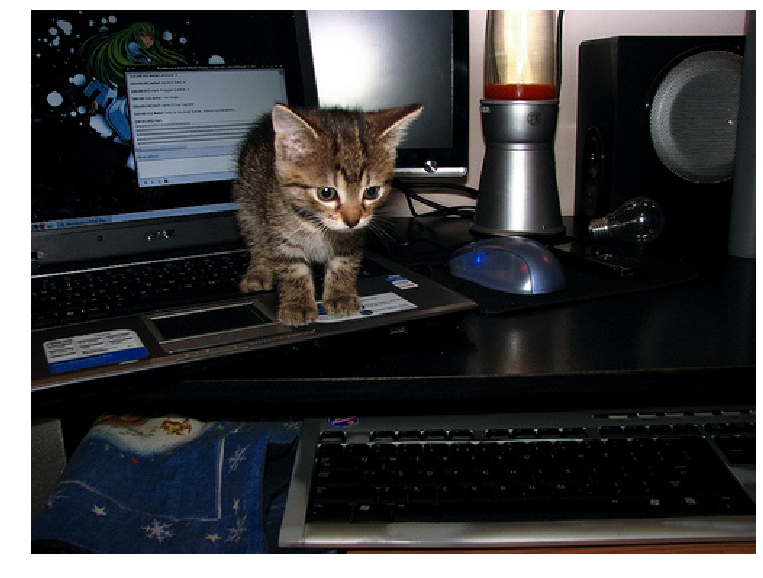

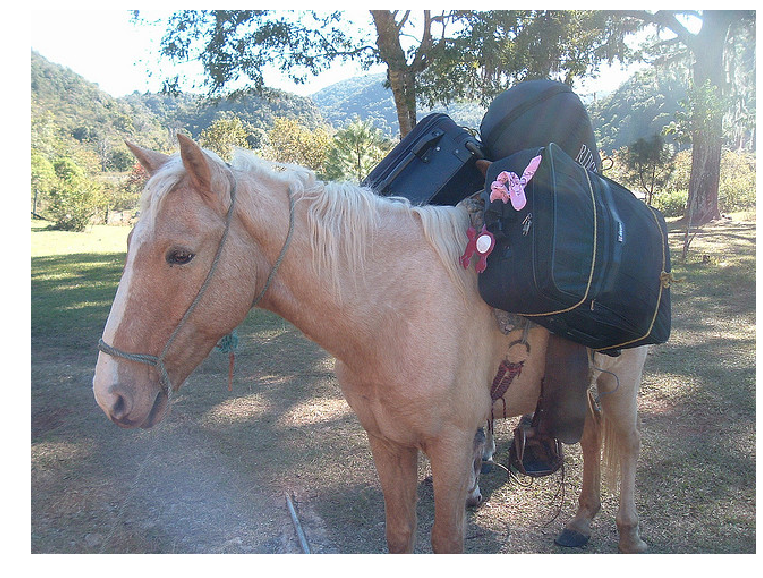

In [8]:
images = np.array([mpimg.imread(x) for x in x_test])
disp(images)

Print the original dimensions:

In [13]:
print([x.shape for x in images])

[(640, 480, 3), (640, 480, 3), (640, 434, 3), (640, 480, 3), (480, 640, 3), (333, 500, 3), (451, 640, 3), (640, 554, 3)]


Preprocess the test images and see the dimensions

In [9]:
images_test = np.array([coco.preprocess_for_vgg(x) for x in x_test])
print(images_test.shape)

(8, 224, 224, 3)


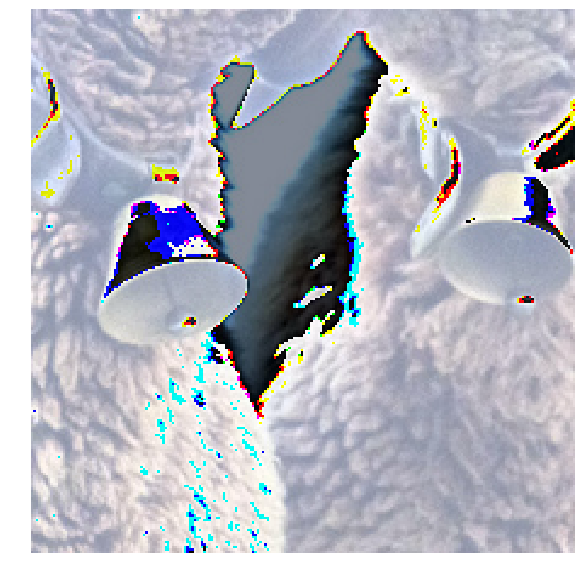

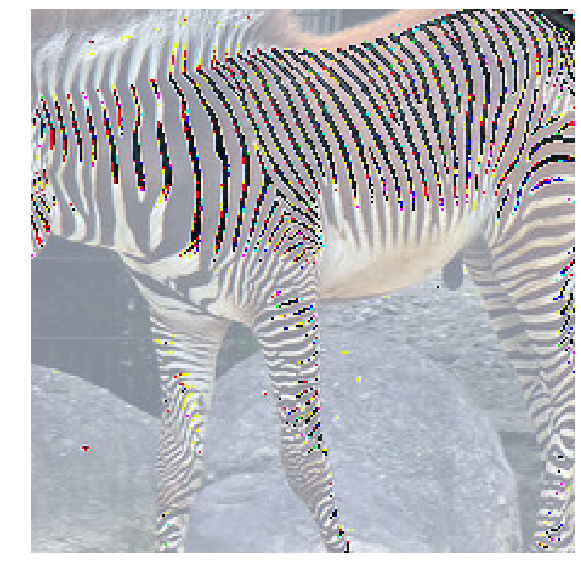

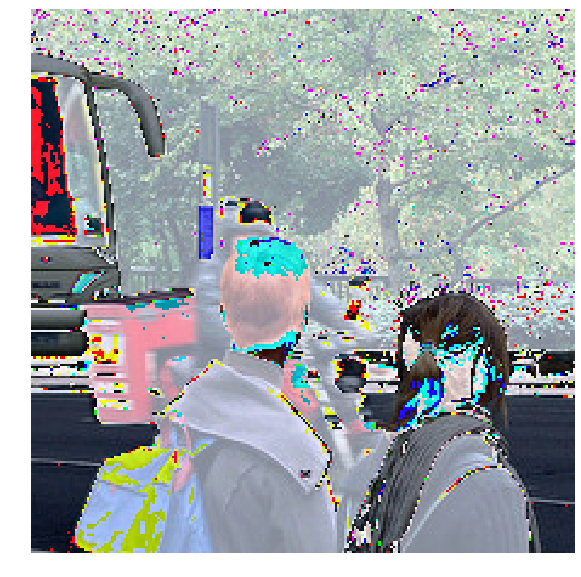

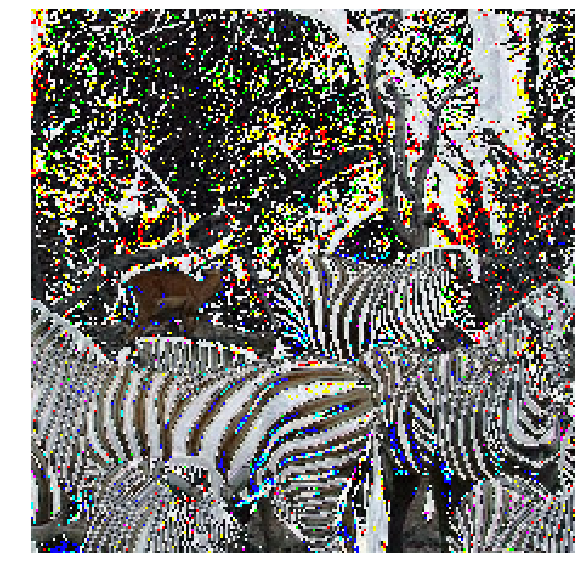

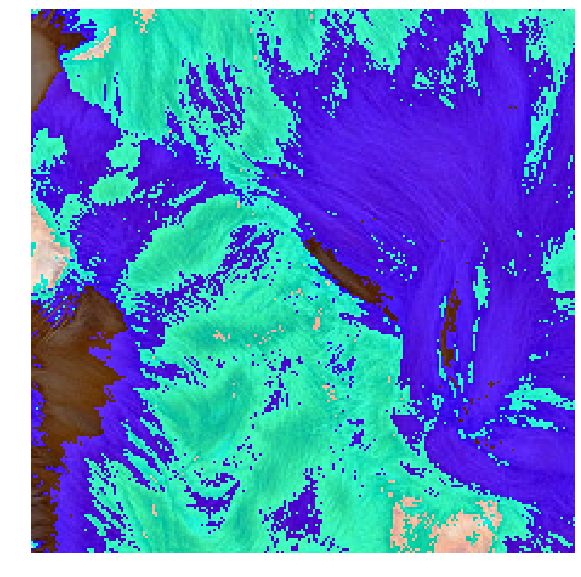

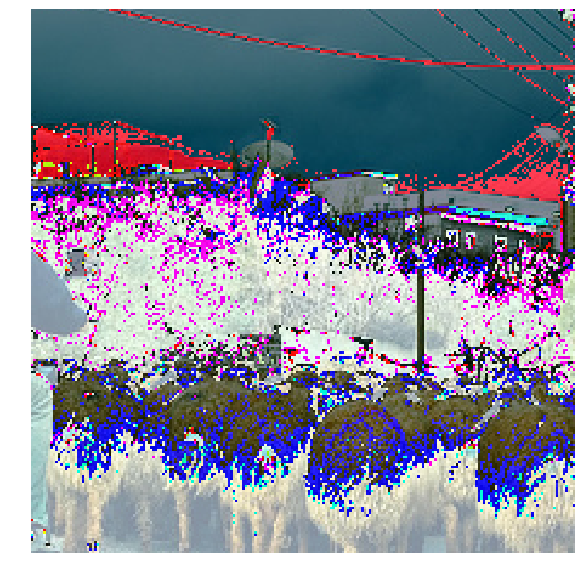

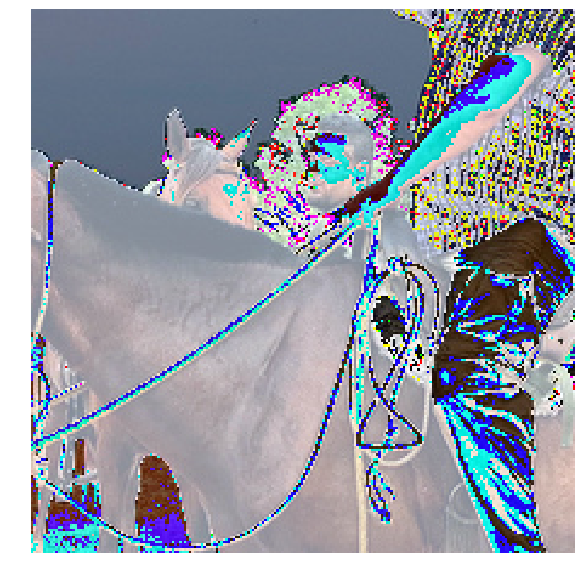

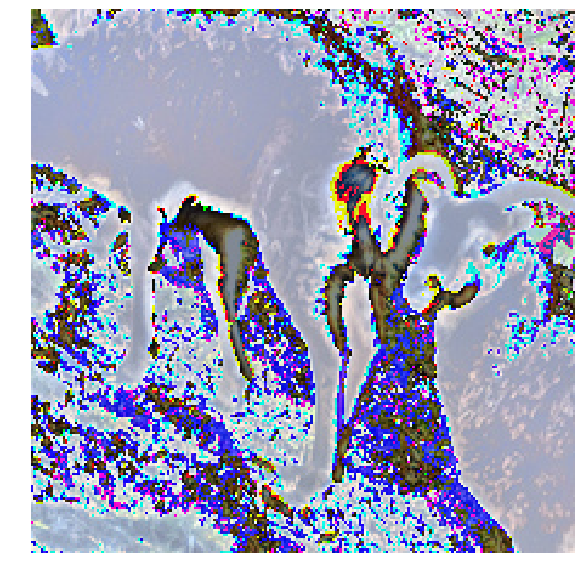

In [15]:
disp(images_test)

We can also see the scaled images by setting `scale=True`

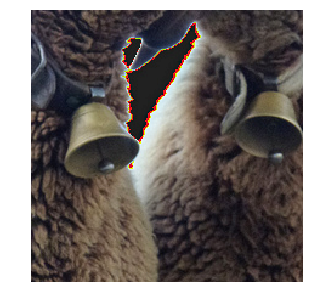

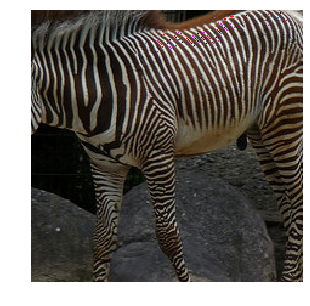

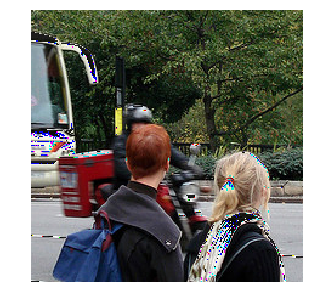

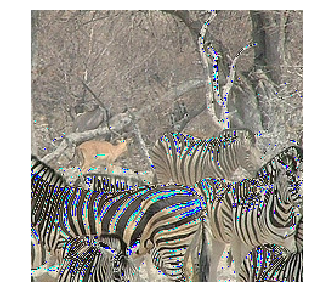

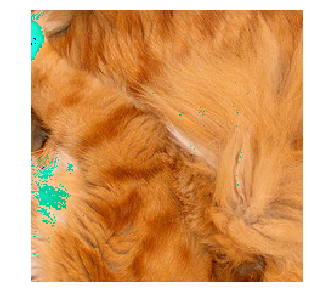

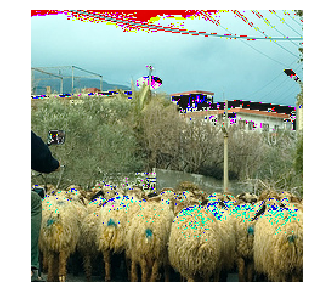

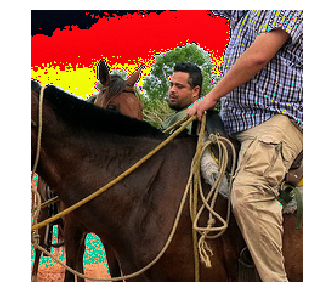

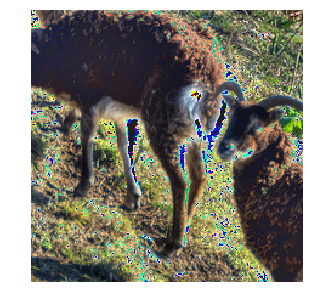

In [16]:
disp(images_test, scale=True)

#VGG16 in TensorFlow
To use VGG16, download the checkpoint file and then initialize variables,

In [10]:
# download the checkpoint file
model_name = 'vgg_16'
model_url = 'http://download.tensorflow.org/models/'
model_files = ['vgg_16_2016_08_28.tar.gz']
model_home = os.path.join(models_root, model_name)

dsu.download_dataset(source_url=model_url,
                     source_files=model_files,
                     dest_dir=model_home,
                     force=False,
                     extract=True)

Downloading: http://download.tensorflow.org/models/vgg_16_2016_08_28.tar.gz
Downloaded : /root/models/vgg_16/vgg_16_2016_08_28.tar.gz ( 513324920 bytes)


['vgg_16_2016_08_28.tar.gz']

Also need to define some common imports and variables

In [0]:
# imports and common variables for VGG16
from tensorflow.contrib import slim
from tensorflow.contrib.slim.nets import vgg
image_height = vgg.vgg_16.default_image_size
image_width = vgg.vgg_16.default_image_size

##Image classification using pre-trained VGG16 in TensorFlow
First, need to clear the default graph and define a placeholder for images,

In [0]:
tf.reset_default_graph()

In [28]:
x_p = tf.placeholder(shape=(None, image_height, image_width, 3),
                     dtype=tf.float32,
                     name='x_p')
print(x_p)

Tensor("x_p:0", shape=(?, 224, 224, 3), dtype=float32)


Next, load the `vgg16` model,

In [0]:
with slim.arg_scope(vgg.vgg_arg_scope()):
  logits, _ = vgg.vgg_16(x_p, num_classes=inet.n_classes, is_training=False)

Add the softmax layer for producing probabilities over the classes,

In [0]:
probabilities = tf.nn.softmax(logits)

Define the initialization function to restore the variables from the checkpoint file,

In [0]:
init = slim.assign_from_checkpoint_fn(
                 os.path.join(model_home, '{}.ckpt'.format(model_name)),
                 slim.get_variables_to_restore())

Initialize the variables and run the probability tensor to get the probabilities of each image within a TensorFlow session,

In [32]:
with tf.Session() as tfs:
  init(tfs)
  probs = tfs.run([probabilities], feed_dict={x_p:images_test})
  probs = probs[0]

INFO:tensorflow:Restoring parameters from /root/models/vgg_16/vgg_16.ckpt


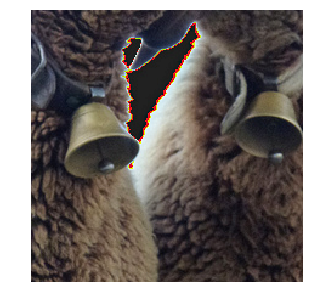

Probability 62.84% of [teddy, teddy bear]
Probability 11.76% of [ram, tup]
Probability 3.19% of [koala, koala bear, kangaroo bear, native bear, Phascolarctos cinereus]
Probability 3.13% of [standard poodle]
Probability 3.10% of [curly-coated retriever]


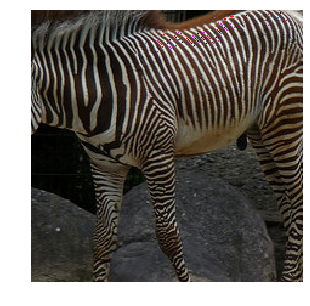

Probability 99.87% of [zebra]
Probability 0.04% of [gazelle]
Probability 0.03% of [impala, Aepyceros melampus]
Probability 0.01% of [hartebeest]
Probability 0.00% of [jaguar, panther, Panthera onca, Felis onca]


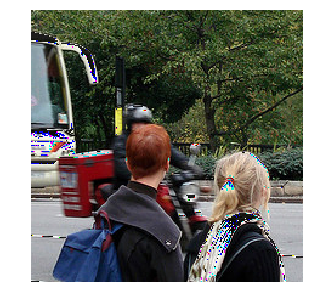

Probability 9.62% of [jinrikisha, ricksha, rickshaw]
Probability 8.20% of [minibus]
Probability 6.38% of [academic gown, academic robe, judge's robe]
Probability 5.05% of [minivan]
Probability 4.11% of [garbage truck, dustcart]


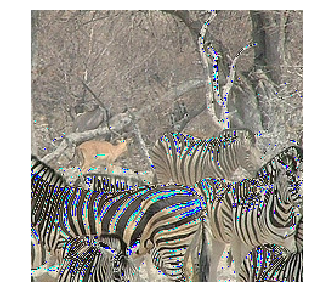

Probability 99.96% of [zebra]
Probability 0.02% of [impala, Aepyceros melampus]
Probability 0.01% of [gazelle]
Probability 0.01% of [hartebeest]
Probability 0.00% of [maze, labyrinth]


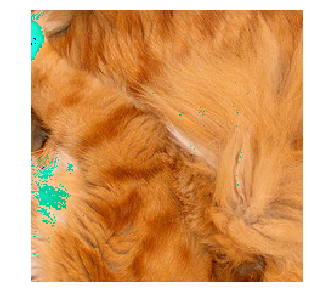

Probability 40.54% of [Persian cat]
Probability 23.43% of [chow, chow chow]
Probability 9.42% of [golden retriever]
Probability 6.68% of [Pomeranian]
Probability 5.56% of [tiger cat]


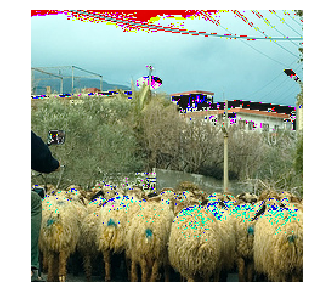

Probability 69.42% of [ram, tup]
Probability 8.48% of [oxcart]
Probability 7.24% of [ox]
Probability 4.92% of [bighorn, bighorn sheep, cimarron, Rocky Mountain bighorn, Rocky Mountain sheep, Ovis canadensis]
Probability 4.32% of [llama]


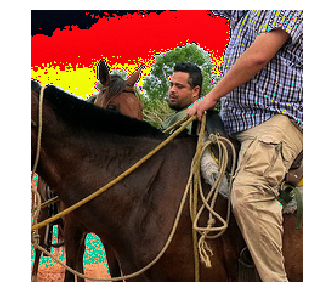

Probability 20.04% of [Indian elephant, Elephas maximus]
Probability 14.73% of [tusker]
Probability 13.11% of [ox]
Probability 8.73% of [plow, plough]
Probability 5.55% of [Arabian camel, dromedary, Camelus dromedarius]


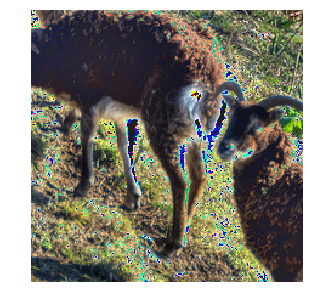

Probability 54.29% of [ram, tup]
Probability 32.82% of [llama]
Probability 4.34% of [ibex, Capra ibex]
Probability 4.23% of [curly-coated retriever]
Probability 2.66% of [bighorn, bighorn sheep, cimarron, Rocky Mountain bighorn, Rocky Mountain sheep, Ovis canadensis]


In [33]:
disp(images_test, id2label=inet.id2label, probs=probs, scale=True)

##Image preprocessing in TensorFlow for pre-trained VGG16
Define a function for preprocessing steps in TensorFlow,

In [0]:
tf.reset_default_graph()

In [0]:
def tf_preprocess(filelist):
  images = []
  for filename in filelist:
    image_string = tf.read_file(filename)
    image_decoded = tf.image.decode_jpeg(image_string, channels=3)
    image_float = tf.cast(image_decoded, tf.float32)
    resize_fn = tf.image.resize_image_with_crop_or_pad
    image_resized = resize_fn(image_float, image_height, image_width)
    means = tf.reshape(tf.constant([123.68, 116.78, 103.94]), [1, 1, 3])
    image = image_resized - means
    images.append(image)
    
  images = tf.stack(images)
  return images

Create the `images` variable instead of a placeholder,

In [39]:
images = tf_preprocess([x for x in x_test])
print(images)

Tensor("stack:0", shape=(8, 224, 224, 3), dtype=float32)


Restore the variables and run the prediction just as the same process we did before to define the VGG16 model,

In [0]:
with slim.arg_scope(vgg.vgg_arg_scope()):
  logits, _ = vgg.vgg_16(images, num_classes=inet.n_classes, is_training=False)
  
probabilities = tf.nn.softmax(logits)

init = slim.assign_from_checkpoint_fn(
              os.path.join(model_home, '{}.ckpt'.format(model_name)),
              slim.get_variables_to_restore())

In [41]:
with tf.Session() as tfs:
  init(tfs)
  preproc_images, probs = tfs.run([images, probabilities])

INFO:tensorflow:Restoring parameters from /root/models/vgg_16/vgg_16.ckpt


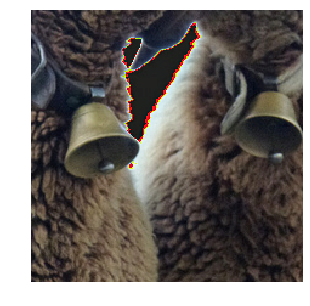

Probability 56.87% of [teddy, teddy bear]
Probability 16.30% of [ram, tup]
Probability 3.71% of [koala, koala bear, kangaroo bear, native bear, Phascolarctos cinereus]
Probability 2.74% of [Irish water spaniel]
Probability 2.67% of [standard poodle]


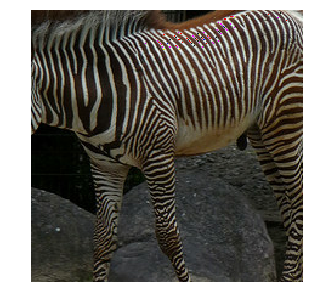

Probability 99.88% of [zebra]
Probability 0.04% of [gazelle]
Probability 0.03% of [impala, Aepyceros melampus]
Probability 0.01% of [hartebeest]
Probability 0.00% of [jaguar, panther, Panthera onca, Felis onca]


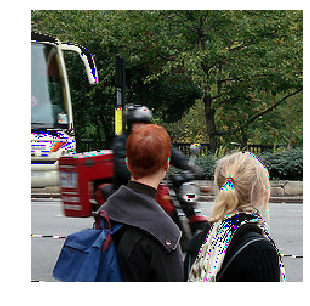

Probability 9.12% of [jinrikisha, ricksha, rickshaw]
Probability 8.37% of [minibus]
Probability 6.30% of [academic gown, academic robe, judge's robe]
Probability 5.04% of [minivan]
Probability 4.19% of [garbage truck, dustcart]


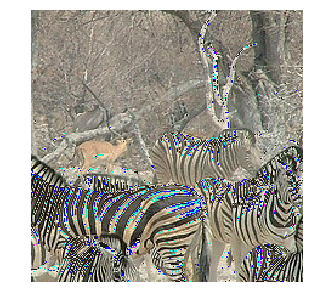

Probability 99.95% of [zebra]
Probability 0.02% of [impala, Aepyceros melampus]
Probability 0.01% of [gazelle]
Probability 0.01% of [hartebeest]
Probability 0.00% of [maze, labyrinth]


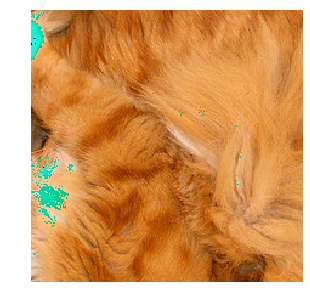

Probability 40.36% of [Persian cat]
Probability 23.50% of [chow, chow chow]
Probability 8.95% of [golden retriever]
Probability 6.42% of [Pomeranian]
Probability 6.29% of [tiger cat]


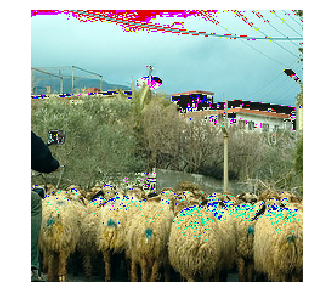

Probability 67.26% of [ram, tup]
Probability 9.28% of [oxcart]
Probability 8.16% of [ox]
Probability 4.89% of [llama]
Probability 4.70% of [bighorn, bighorn sheep, cimarron, Rocky Mountain bighorn, Rocky Mountain sheep, Ovis canadensis]


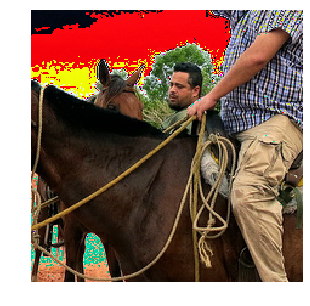

Probability 23.32% of [Indian elephant, Elephas maximus]
Probability 15.63% of [tusker]
Probability 14.43% of [ox]
Probability 7.95% of [plow, plough]
Probability 6.03% of [Arabian camel, dromedary, Camelus dromedarius]


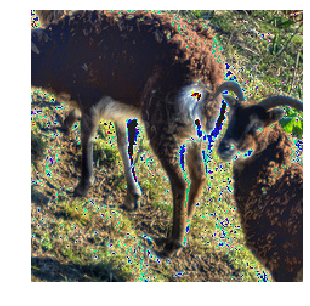

Probability 58.33% of [ram, tup]
Probability 25.67% of [llama]
Probability 5.82% of [ibex, Capra ibex]
Probability 4.57% of [curly-coated retriever]
Probability 3.67% of [bighorn, bighorn sheep, cimarron, Rocky Mountain bighorn, Rocky Mountain sheep, Ovis canadensis]


In [42]:
disp(preproc_images, id2label=inet.id2label, probs=probs, scale=True)

As you can see, the class probabilities are the same as before. The preprocessing steps can be done in TensorFlow.

It is recommended to keep the preprocessing pipelines separate from
the TensorFlow Model Training and Predictions code. Keeping it separate
makes it modular and has other advantages, such as you can save the data
for reuse in multiple models.

##Image classification using retrained VGG16 in TensorFlow
Here, need to define three placeholders,
* `is_training` placeholder specifies if we are using the model for training or for predictions
* `x_p` is a placeholder of shape `(None, image_height, image_width, 3)` for inputs
* `y_p` is a placeholder of shape `(None, 1)` for outputs

In [0]:
tf.reset_default_graph()

In [0]:
is_training = tf.placeholder(tf.bool, name='is_training')
x_p = tf.placeholder(shape=(None, image_height, image_width, 3),
                     dtype=tf.float32, name='x_p')
y_p = tf.placeholder(shape=(None, 1), dtype=tf.int32, name='y_p')

Restore the layers from the checkpoint file except for the last layer which is called `vgg/fc8` layer:

In [0]:
with slim.arg_scope(vgg.vgg_arg_scope()):
  logits,_ = vgg.vgg_16(x_p, num_classes=coco.n_classes, is_training=is_training)
  
probabilities = tf.nn.softmax(logits)

# restore except last layer fc8
restore_fn = tf.contrib.framework.get_variables_to_restore
fc7_variables = restore_fn(exclude=['vgg_16/fc8'])

fc7_init = tf.contrib.framework.assign_from_checkpoint_fn(
               os.path.join(model_home, '{}.ckpt'.format(model_name)),
               fc7_variables)

Next, define the last layer's variables to be initialized, not restored,

In [0]:
# fc8 layer
fc8_variables = tf.contrib.framework.get_variables('vgg_16/fc8')
fc8_init = tf.variables_initializer(fc8_variables)

Define the loss function,

In [0]:
tf.losses.sparse_softmax_cross_entropy(labels=y_p, logits=logits)
loss = tf.losses.get_total_loss()

Train the last layer for a few epochs and then train the full network for a few layers. Thus, define two separate optimizer and training operations,

In [0]:
learning_rate = 0.001

fc8_optimizer = tf.train.GradientDescentOptimizer(learning_rate=learning_rate)
fc8_train_op = fc8_optimizer.minimize(loss, var_list=fc8_variables)

full_optimizer = tf.train.GradientDescentOptimizer(learning_rate=learning_rate)
full_train_op = full_optimizer.minimize(loss)

The `learning_rate` for both optimizers does not have to be the same. You can define different learning rate to tune this hyper-parameter

Define the accuracy,

In [0]:
y_pred = tf.to_int32(tf.argmax(logits, 1))
n_correct_pred = tf.equal(y_pred, y_p)
accuracy = tf.reduce_mean(tf.cast(n_correct_pred, tf.float32))

Finally, run the training for the last layer for 10 epochs, and then for the full network for 10 epochs, using a batch size of 32.

In [0]:
fc8_epochs = 10
full_epochs = 10
coco.y_onehot = False
coco.batch_size = 32
coco.batch_shuffle = True

total_images = len(x_train_files)
n_batches = total_images // coco.batch_size

In [20]:
with tf.Session() as tfs:
  fc7_init(tfs)
  tfs.run(fc8_init)
  
  # fc8 layer
  for epoch in range(fc8_epochs):
    print('Starting fc8 epoch ', epoch)
    coco.reset_index()
    epoch_accuracy = 0
    for batch in range(n_batches):
      try:
        x_batch, y_batch = coco.next_batch()
        images = np.array([coco.preprocess_for_vgg(x) for x in x_batch])
        # fc8 training
        feed_dict = {x_p:images, y_p:y_batch, is_training:True}
        tfs.run(fc8_train_op, feed_dict=feed_dict)
        # fc8 training prediction
        feed_dict = {x_p:images, y_p:y_batch, is_training:False}
        batch_accuracy = tfs.run(accuracy, feed_dict=feed_dict)
        epoch_accuracy += batch_accuracy
      except Exception as ex:
        print('Error in fc8 epoch {} batch {}'.format(epoch, batch))
        raise(ex)
    epoch_accuracy /= n_batches
    print('Train accuracy in epoch {}:{}'.format(epoch, epoch_accuracy))
    
    # full network
  for epoch in range(full_epochs):
    print('Starting full epoch', epoch)
    coco.reset_index()
    epoch_accuracy = 0
    for batch in range(n_batches):
      try:
        x_batch, y_batch = coco.next_batch()
        images=np.array([coco.preprocess_for_vgg(x) for x in x_batch])
        # full training          
        feed_dict = {x_p: images,y_p: y_batch,is_training: True}
        tfs.run(full_train_op, feed_dict = feed_dict )
        # full training prediction
        feed_dict={x_p: images, y_p: y_batch,is_training: False}
        batch_accuracy = tfs.run(accuracy,feed_dict=feed_dict)
        epoch_accuracy += batch_accuracy
      except:
        print('error in full epoch {} batch {}'.format(epoch,batch))
        raise(ex)
    epoch_accuracy /= n_batches
    print('Train accuracy in epoch {}:{}'.format(epoch,epoch_accuracy))
    
  # run testing prediction
  feed_dict = {x_p:images_test, is_training:False}
  probs = tfs.run([probabilities], feed_dict=feed_dict)
  probs = probs[0]

INFO:tensorflow:Restoring parameters from /root/models/vgg_16/vgg_16.ckpt
Starting fc8 epoch  0
Train accuracy in epoch 0:0.1334375
Starting fc8 epoch  1
Train accuracy in epoch 1:0.145234375
Starting fc8 epoch  2
Train accuracy in epoch 2:0.1442578125
Starting fc8 epoch  3
Train accuracy in epoch 3:0.1526171875
Starting fc8 epoch  4
Train accuracy in epoch 4:0.14609375
Starting fc8 epoch  5
Train accuracy in epoch 5:0.1471875
Starting fc8 epoch  6
Train accuracy in epoch 6:0.145859375
Starting fc8 epoch  7
Train accuracy in epoch 7:0.1521484375
Starting fc8 epoch  8
Train accuracy in epoch 8:0.143828125
Starting fc8 epoch  9
Train accuracy in epoch 9:0.1433203125
Starting full epoch 0
Train accuracy in epoch 0:0.14921875
Starting full epoch 1
Train accuracy in epoch 1:0.1539453125
Starting full epoch 2
Train accuracy in epoch 2:0.1487109375
Starting full epoch 3
Train accuracy in epoch 3:0.147265625
Starting full epoch 4
Train accuracy in epoch 4:0.156640625
Starting full epoch 5
Trai

Display the results

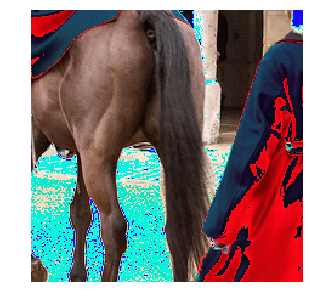

Probability 99.99% of [horse]
Probability 0.00% of [dog]
Probability 0.00% of [giraffe]
Probability 0.00% of [zebra]
Probability 0.00% of [sheep]


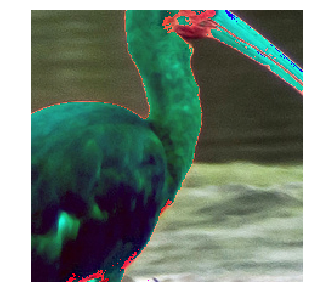

Probability 100.00% of [bird]
Probability 0.00% of [horse]
Probability 0.00% of [giraffe]
Probability 0.00% of [zebra]
Probability 0.00% of [bear]


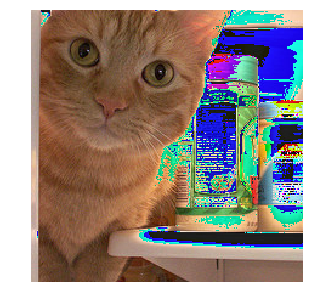

Probability 100.00% of [cat]
Probability 0.00% of [dog]
Probability 0.00% of [bird]
Probability 0.00% of [sheep]
Probability 0.00% of [bear]


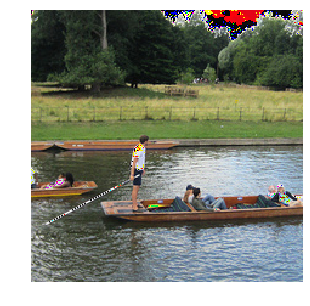

Probability 99.92% of [bird]
Probability 0.06% of [horse]
Probability 0.01% of [dog]
Probability 0.01% of [giraffe]
Probability 0.00% of [zebra]


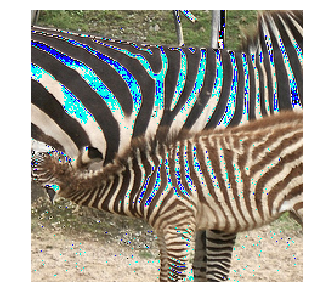

Probability 100.00% of [zebra]
Probability 0.00% of [giraffe]
Probability 0.00% of [cat]
Probability 0.00% of [horse]
Probability 0.00% of [bird]


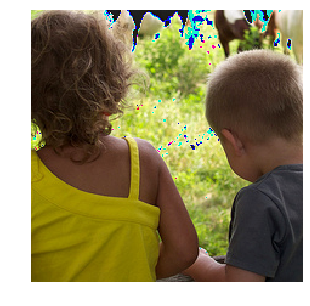

Probability 95.40% of [horse]
Probability 1.51% of [bird]
Probability 1.36% of [dog]
Probability 1.04% of [sheep]
Probability 0.31% of [cat]


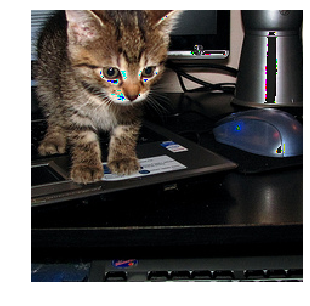

Probability 100.00% of [cat]
Probability 0.00% of [dog]
Probability 0.00% of [bird]
Probability 0.00% of [bear]
Probability 0.00% of [sheep]


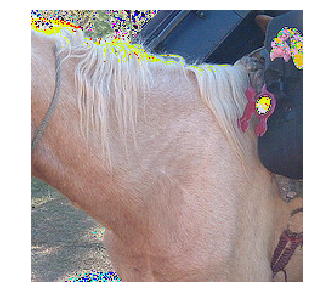

Probability 99.68% of [horse]
Probability 0.22% of [dog]
Probability 0.07% of [sheep]
Probability 0.02% of [cat]
Probability 0.01% of [giraffe]


In [22]:
disp(images_test, id2label=coco.id2label, probs=probs, scale=True)

#VGG16 in Keras
##Image classification using pre-trained VGG16 in Keras
Load the model,

In [0]:
tf.reset_default_graph()
keras.backend.clear_session()

In [25]:
# load the vgg model
from keras.applications import VGG16

model = VGG16(weights='imagenet')

553467904/553467096 [==============================] - 35s 0us/step


Use this model to predict the probabilities of classes,

In [26]:
probs = model.predict(images_test)
print(probs.shape)

(8, 1000)


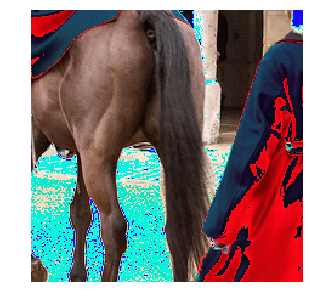

Probability 24.15% of [cloak]
Probability 11.11% of [Great Dane]
Probability 10.79% of [Weimaraner]
Probability 5.98% of [Doberman, Doberman pinscher]
Probability 4.73% of [Mexican hairless]


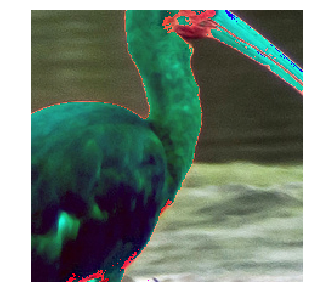

Probability 50.10% of [American egret, great white heron, Egretta albus]
Probability 17.46% of [flamingo]
Probability 16.22% of [spoonbill]
Probability 6.54% of [crane]
Probability 5.57% of [little blue heron, Egretta caerulea]


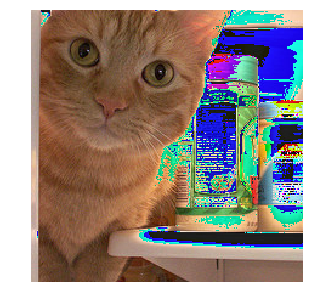

Probability 68.15% of [refrigerator, icebox]
Probability 8.76% of [bucket, pail]
Probability 3.79% of [tabby, tabby cat]
Probability 2.93% of [washer, automatic washer, washing machine]
Probability 1.49% of [medicine chest, medicine cabinet]


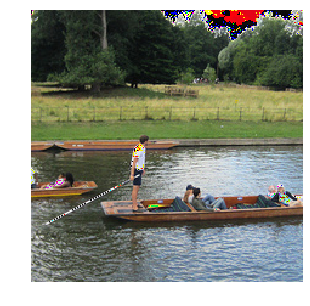

Probability 77.64% of [canoe]
Probability 20.17% of [paddle, boat paddle]
Probability 1.62% of [gondola]
Probability 0.37% of [speedboat]
Probability 0.06% of [sandbar, sand bar]


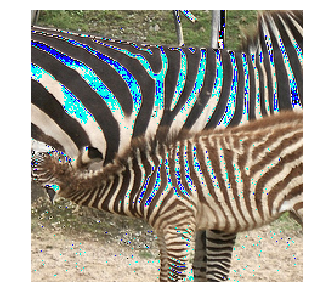

Probability 100.00% of [zebra]
Probability 0.00% of [tiger, Panthera tigris]
Probability 0.00% of [gazelle]
Probability 0.00% of [impala, Aepyceros melampus]
Probability 0.00% of [hartebeest]


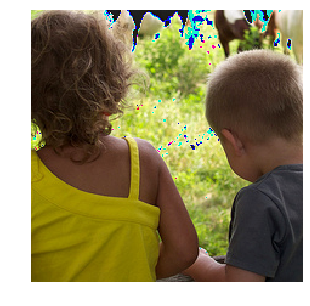

Probability 36.39% of [sunscreen, sunblock, sun blocker]
Probability 8.67% of [ice lolly, lolly, lollipop, popsicle]
Probability 3.85% of [wig]
Probability 2.85% of [hair spray]
Probability 2.46% of [koala, koala bear, kangaroo bear, native bear, Phascolarctos cinereus]


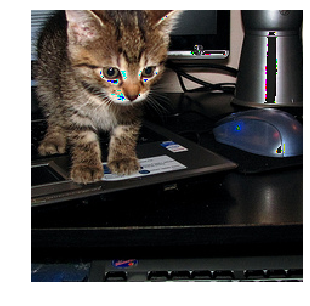

Probability 18.72% of [mouse, computer mouse]
Probability 13.39% of [monitor]
Probability 11.32% of [desktop computer]
Probability 10.65% of [computer keyboard, keypad]
Probability 10.09% of [screen, CRT screen]


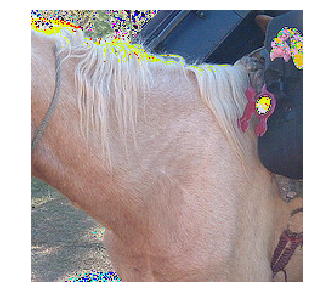

Probability 12.98% of [ox]
Probability 8.98% of [Indian elephant, Elephas maximus]
Probability 8.67% of [Weimaraner]
Probability 8.62% of [bull mastiff]
Probability 5.18% of [pug, pug-dog]


In [27]:
disp(images_test, id2label=inet.id2label, probs=probs, scale=True)

##Image classification using retrained VGG16 in Keras
* remove the last layer in the Keras model and add our own fully connected layer
with `softmax` activation for 8 classes.
* also try to freeze the first few
layers by setting the `trainable` attribute of the first 15 layers to `False`

Start by importing the VGG16 model without the variables for the top layer, by setting the `include_top` to `False`,

In [0]:
tf.reset_default_graph()
keras.backend.clear_session()

In [0]:
# load the vgg model
from keras.applications import VGG16

base_model = VGG16(weights='imagenet',
                   include_top=False,
                   input_shape=(224,224,3))

Build the classifier model to put on top of the imported VGG model,

In [0]:
from keras.models import Sequential, Model
from keras.layers import Dropout, Flatten, Dense
from keras import optimizers

# build a classifier model to put on top of the VGG model
top_model = Sequential()
top_model.add(Flatten(input_shape=base_model.output_shape[1:]))
top_model.add(Dense(256, activation='relu'))
top_model.add(Dropout(0.5))
top_model.add(Dense(coco.n_classes, activation='softmax'))

In [48]:
top_model.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
flatten_1 (Flatten)          (None, 25088)             0         
_________________________________________________________________
dense_1 (Dense)              (None, 256)               6422784   
_________________________________________________________________
dropout_1 (Dropout)          (None, 256)               0         
_________________________________________________________________
dense_2 (Dense)              (None, 8)                 2056      
Total params: 6,424,840
Trainable params: 6,424,840
Non-trainable params: 0
_________________________________________________________________


The `flatten_1` has the shape of `(None, 25088)` because the last max-pooling layer has the shape of `(None, 7, 7, 512)`. Here we only take off the flatten layer in VGG16

add model on top of the VGG base,

In [0]:
model = Model(inputs=base_model.input, outputs=top_model(base_model.output))

Freeze the first 15 layers,

In [0]:
for layer in model.layers[:15]:
  layer.trainable = False

In [51]:
model.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         (None, 224, 224, 3)       0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 224, 224, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 224, 224, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 112, 112, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 112, 112, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 112, 112, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 56, 56, 128)       0         
__________

Compile the model

In [0]:
model.compile(loss='categorical_crossentropy', 
              optimizer=optimizers.SGD(lr=1e-4, momentum=0.9),
              metrics=['accuracy'])

Train the Keras model for 20 epochs with a batch size of 32,

In [53]:
from keras.utils import np_utils

coco.y_onehot = True
coco.batch_size = 32
coco.batch_shuffle = True
n_epochs = 20

total_images = len(x_train_files)
n_batches = total_images // coco.batch_size

for epoch in range(n_epochs):
  print('Starting epoch ', epoch)
  coco.reset_index()
  for batch in range(n_batches):
    try:
      x_batch, y_batch = coco.next_batch()
      images = np.array([coco.preprocess_for_vgg(x) for x in x_batch])
      model.fit(x=images, y=y_batch, verbose=0)
    except Exception as ex:
      print('Error in epoch {} batch {}'.format(epoch, batch))
      raise(ex)
      
probs = model.predict(images_test)

Starting epoch  0
Starting epoch  1
Starting epoch  2
Starting epoch  3
Starting epoch  4
Starting epoch  5
Starting epoch  6
Starting epoch  7
Starting epoch  8
Starting epoch  9
Starting epoch  10
Starting epoch  11
Starting epoch  12
Starting epoch  13
Starting epoch  14
Starting epoch  15
Starting epoch  16
Starting epoch  17
Starting epoch  18
Starting epoch  19


See the result,

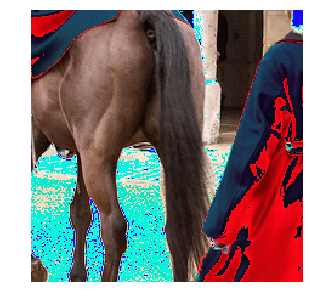

Probability 100.00% of [horse]
Probability 0.00% of [bear]
Probability 0.00% of [cat]
Probability 0.00% of [giraffe]
Probability 0.00% of [dog]


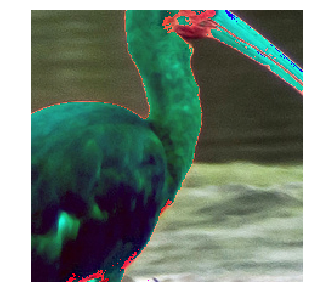

Probability 100.00% of [bird]
Probability 0.00% of [horse]
Probability 0.00% of [dog]
Probability 0.00% of [cat]
Probability 0.00% of [bear]


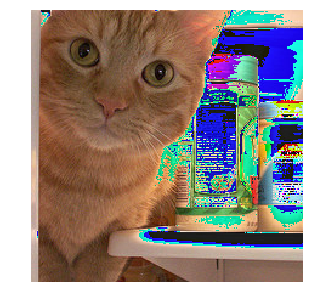

Probability 100.00% of [cat]
Probability 0.00% of [horse]
Probability 0.00% of [dog]
Probability 0.00% of [zebra]
Probability 0.00% of [sheep]


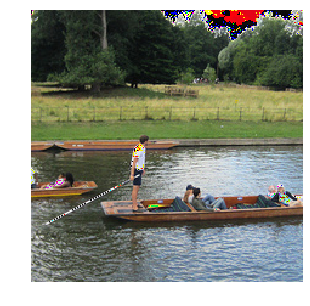

Probability 99.94% of [bird]
Probability 0.03% of [horse]
Probability 0.01% of [dog]
Probability 0.01% of [sheep]
Probability 0.01% of [cat]


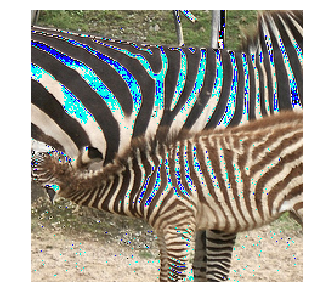

Probability 100.00% of [zebra]
Probability 0.00% of [bird]
Probability 0.00% of [horse]
Probability 0.00% of [sheep]
Probability 0.00% of [bear]


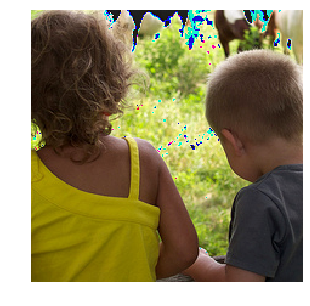

Probability 99.90% of [horse]
Probability 0.03% of [bear]
Probability 0.03% of [dog]
Probability 0.01% of [zebra]
Probability 0.01% of [giraffe]


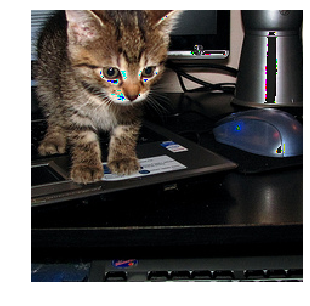

Probability 100.00% of [cat]
Probability 0.00% of [horse]
Probability 0.00% of [dog]
Probability 0.00% of [sheep]
Probability 0.00% of [zebra]


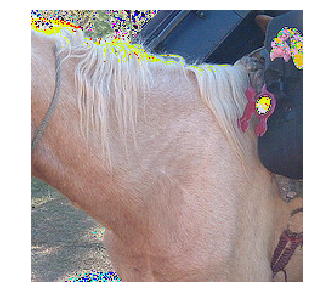

Probability 99.19% of [horse]
Probability 0.62% of [dog]
Probability 0.11% of [sheep]
Probability 0.05% of [cat]
Probability 0.02% of [zebra]


In [54]:
disp(images_test, id2label=coco.id2label, probs=probs, scale=True)

#Inception v3 in TensorFlow
TensorFlow's Inception v3 is trained on 1,001 labels instead of 1,000. Also, the images used
for training are pre-processed differently.

In [0]:
# helper function

def disp(images,id2label=None,probs=None,n_top=5,scale=False):
  if scale:
    imgs = (images / 2.0) + 0.5
  else:
    imgs = images

  ids={}
  for j in range(len(images)):
    if scale:
      plt.figure(figsize=(5,5))
      plt.imshow(imgs[j])
      plt.axis('off')
    else:
      plt.imshow(imgs[j].astype(np.uint8) )
      plt.axis('off')
    plt.show()
    if probs is not None:
      ids[j] = [i[0] for i in sorted(enumerate(-probs[j]), key=lambda x:x[1])]
      for k in range(n_top):
        id = ids[j][k]
        print('Probability {0:1.2f}% of [{1:}]'.format(100*probs[j,id],id2label[id]))

##Load COCO animals dataset

In [56]:
# Load the dataset
from datasetslib.coco import coco_animals

coco = coco_animals()
x_train_files, y_train, x_val_files, x_val = coco.load_data()
x_test = [x_val_files[25*x] for x in range(8)]
images_test=np.array([coco.preprocess_for_inception(x) for x in x_test])

Already exists: /root/datasets/coco-animals/coco-animals.zip


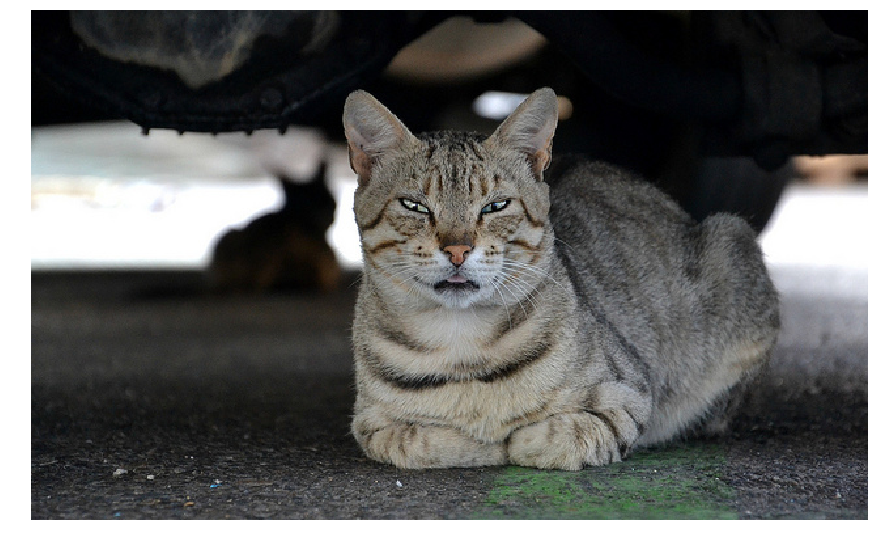

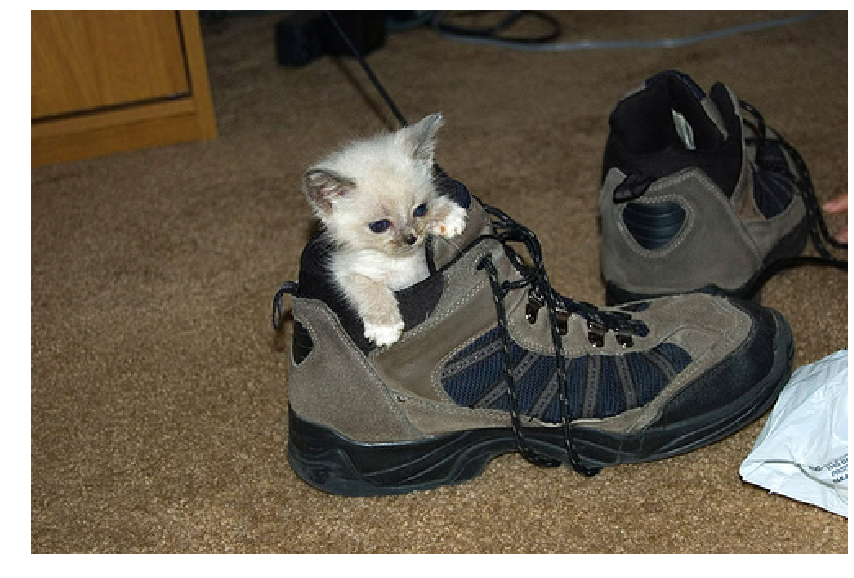

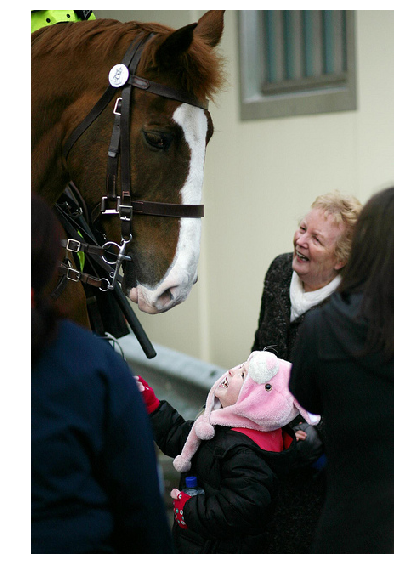

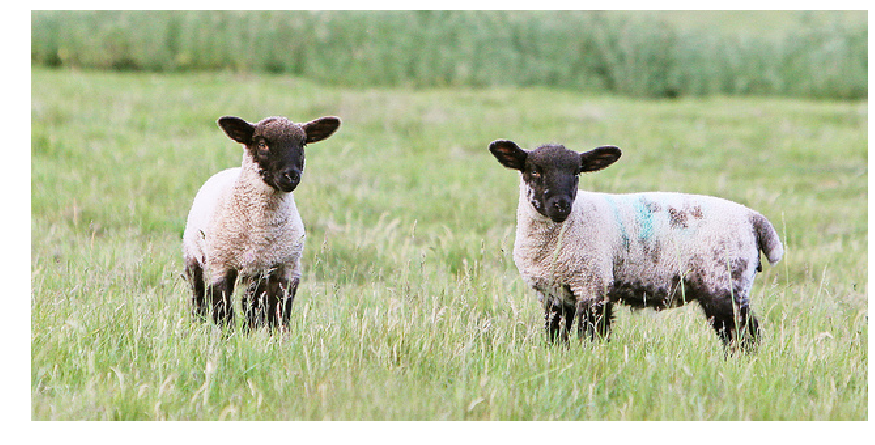

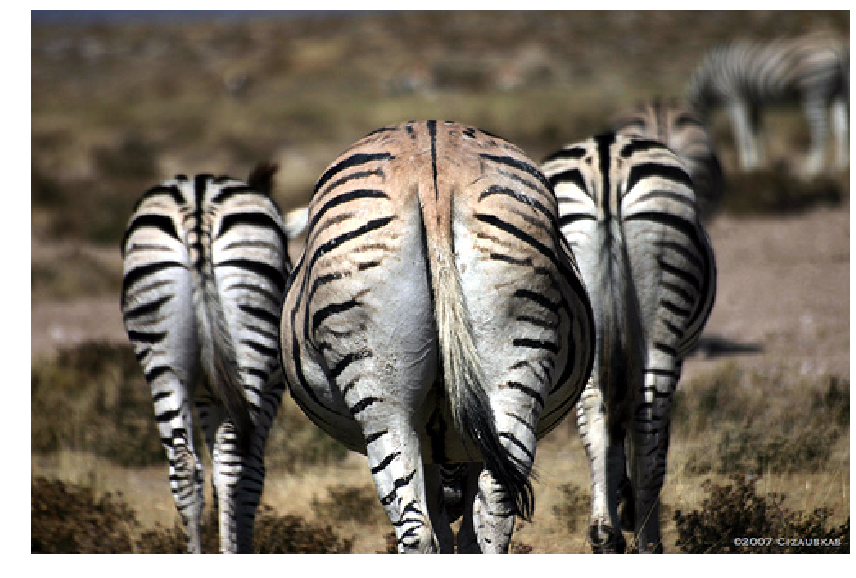

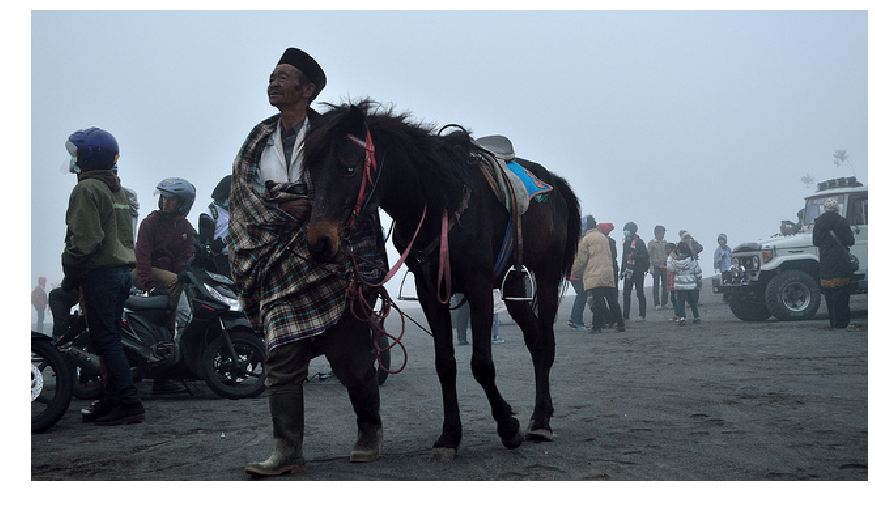

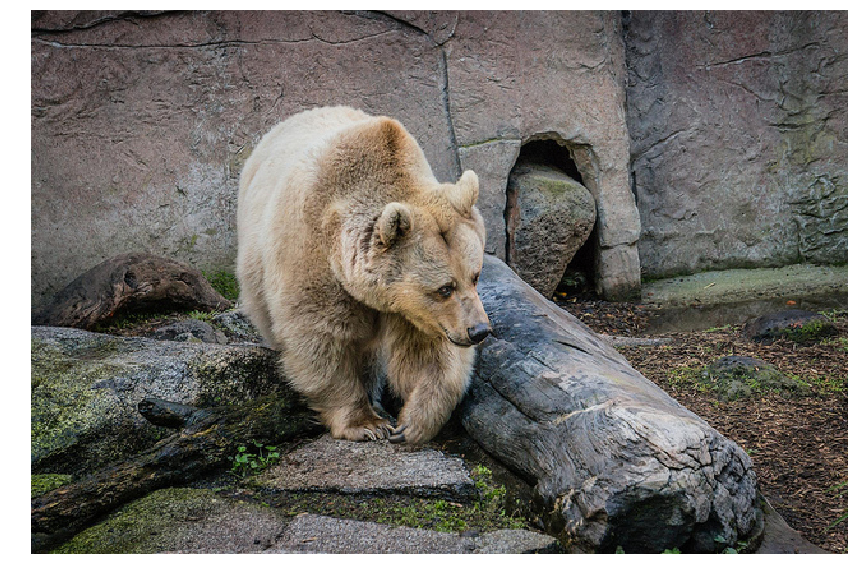

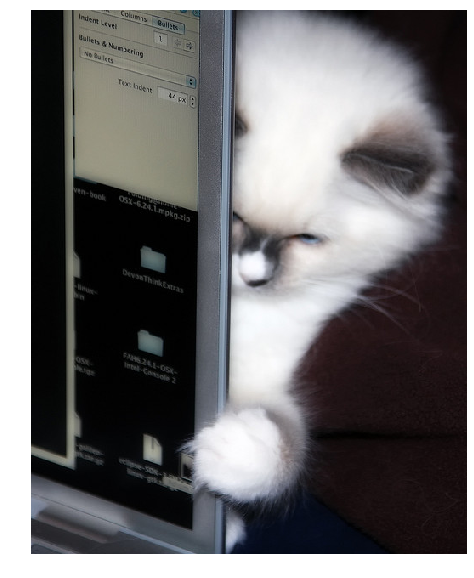

In [63]:
images=np.array([mpimg.imread(x) for x in x_test])

disp(images)

In [64]:
print([x.shape for x in images])

[(390, 640, 3), (333, 500, 3), (640, 427, 3), (314, 640, 3), (332, 500, 3), (360, 640, 3), (426, 640, 3), (640, 513, 3)]


In [65]:
print(images_test.shape)

(8, 299, 299, 3)


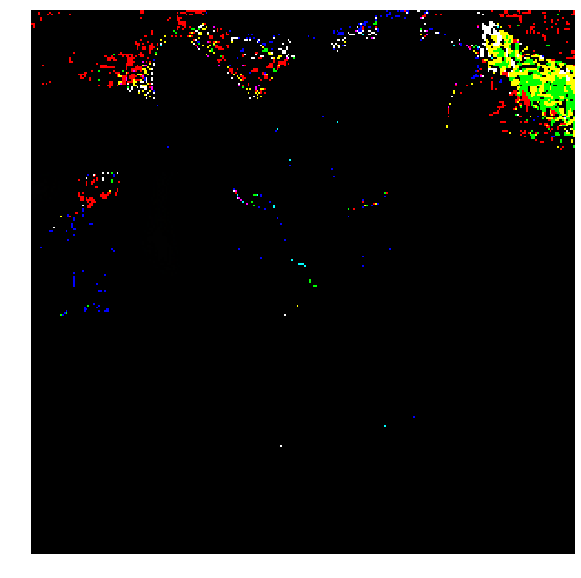

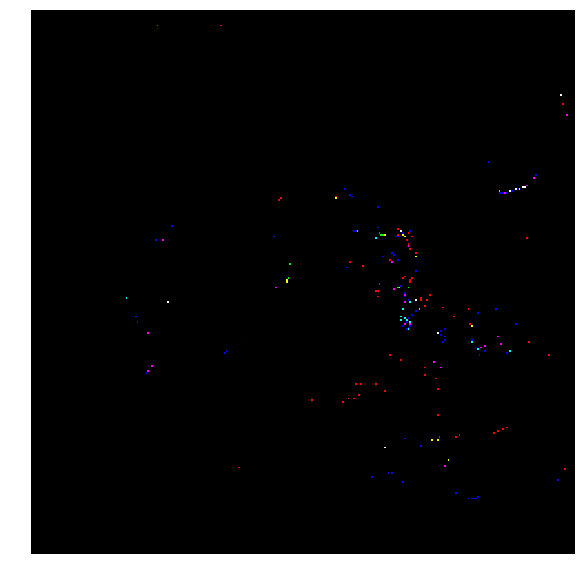

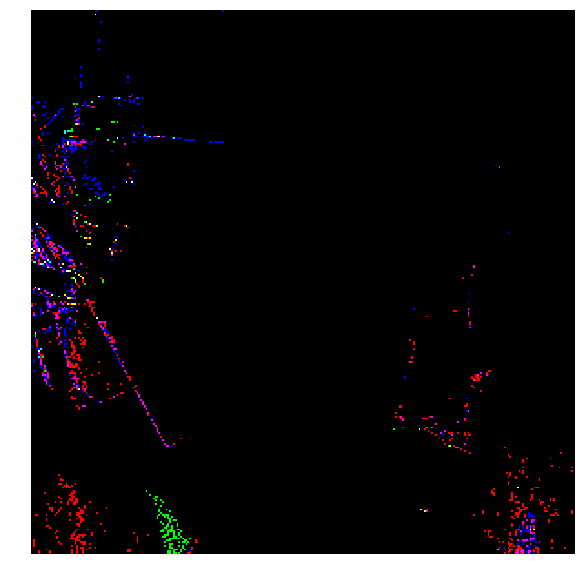

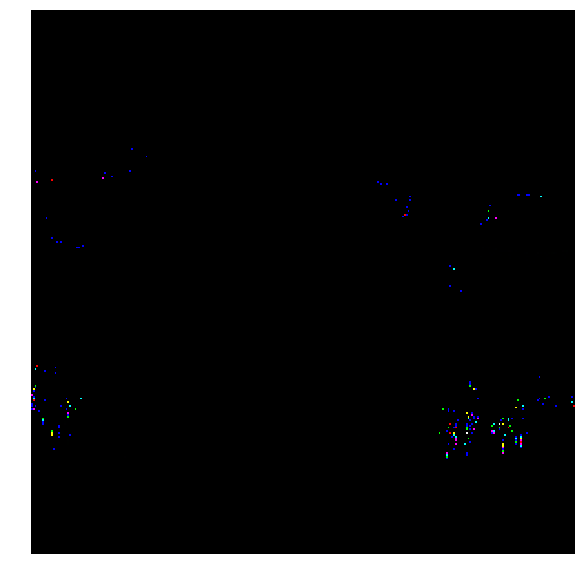

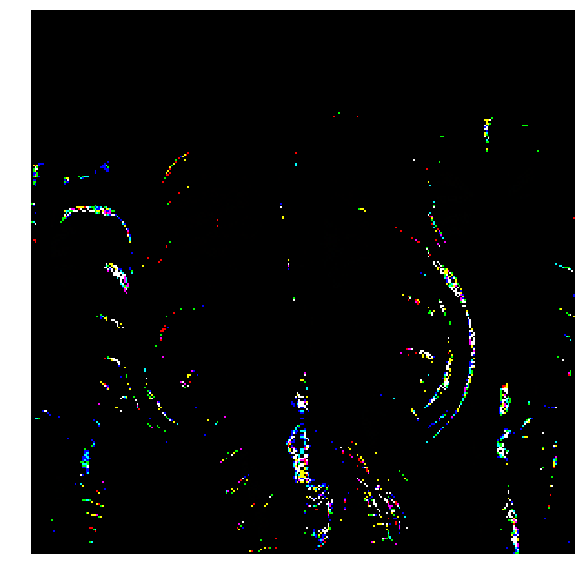

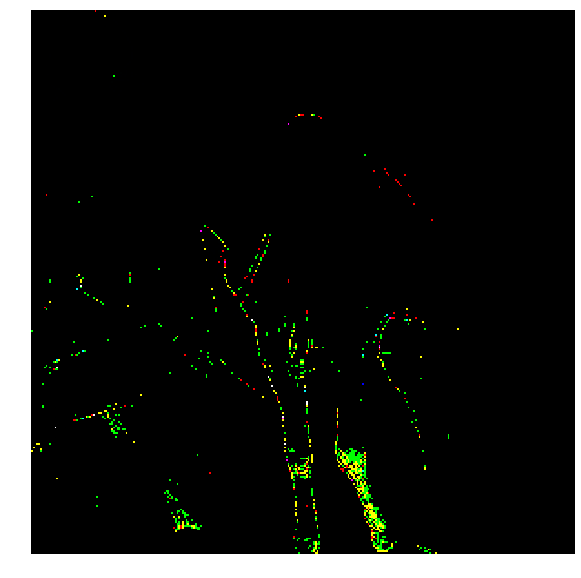

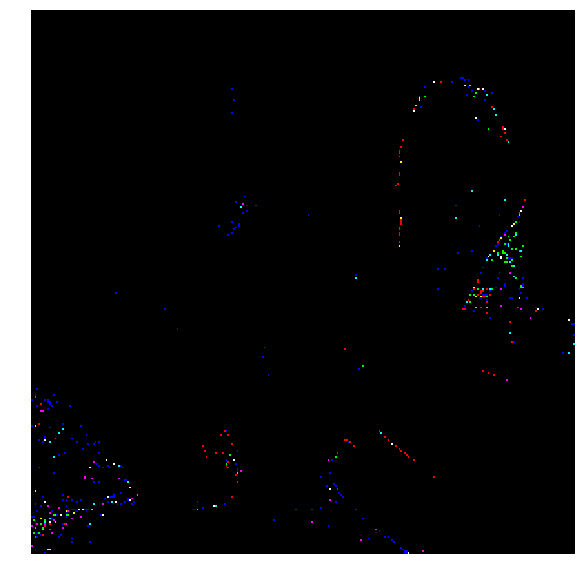

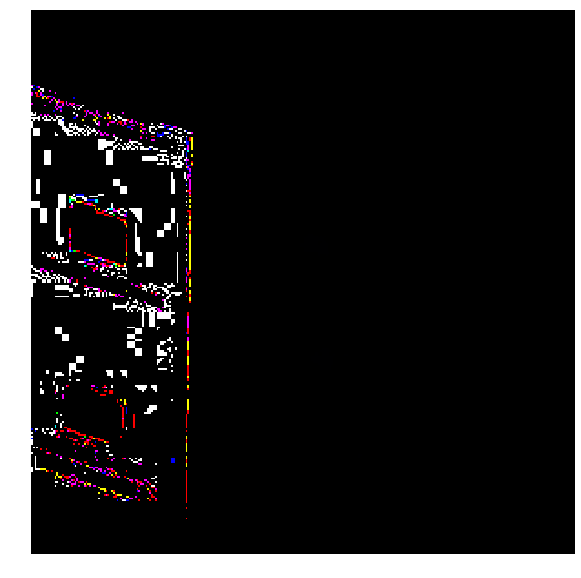

In [66]:
disp(images_test)

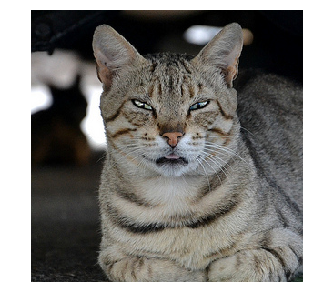

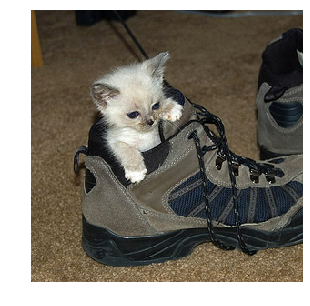

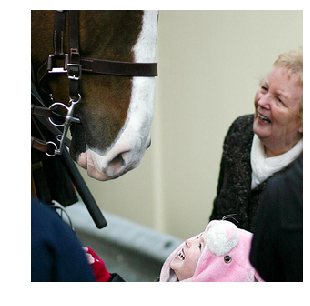

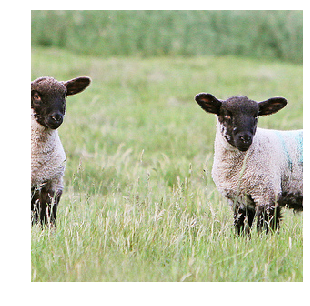

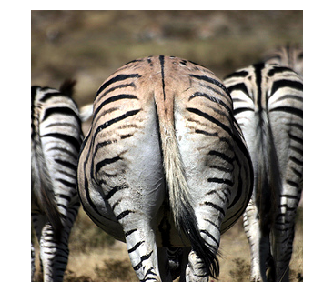

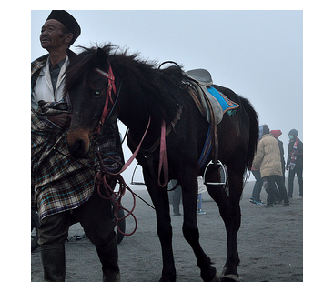

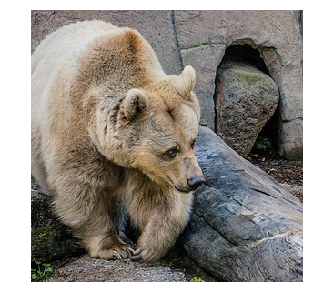

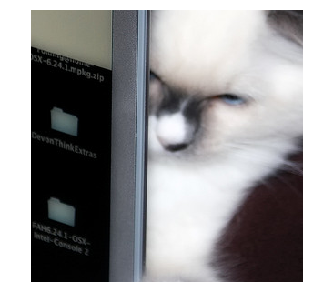

In [67]:
disp(images_test,scale=True)

##Load ImageNet dataset for labels

In [0]:
# load ImageNet dataset for labels
from datasetslib.imagenet import imageNet
inet = imageNet()
inet.load_data(n_classes=1001)

##Load the pretrained Inception model

In [78]:
# load the inception v3 model
model_name='inception_v3'
model_url='http://download.tensorflow.org/models/'
model_files=['inception_v3_2016_08_28.tar.gz']
model_home=os.path.join(models_root,model_name)        
        
dsu.download_dataset(source_url=model_url,
                     source_files=model_files,
                     dest_dir=model_home,
                     force=False,
                     extract=True)

Downloading: http://download.tensorflow.org/models/inception_v3_2016_08_28.tar.gz
Downloaded : /root/models/inception_v3/inception_v3_2016_08_28.tar.gz ( 100885009 bytes)


['inception_v3_2016_08_28.tar.gz']

In [0]:
# define common imports and variables
from tensorflow.contrib.slim.nets import inception
image_height=inception.inception_v3.default_image_size
image_width=inception.inception_v3.default_image_size

##Image classification using Inception v3 in TensorFlow

In [0]:
tf.reset_default_graph()
keras.backend.clear_session()

In [81]:
x_p = tf.placeholder(shape=(None,image_height, image_width,3),
                     dtype=tf.float32,
                     name='x_p')
print(x_p)

Tensor("x_p:0", shape=(?, 299, 299, 3), dtype=float32)


In [0]:
with slim.arg_scope(inception.inception_v3_arg_scope()):
  logits,_ = inception.inception_v3(x_p,
                                    num_classes=inet.n_classes,
                                    is_training=False)
  
probabilities = tf.nn.softmax(logits)

init = slim.assign_from_checkpoint_fn(
                os.path.join(model_home, '{}.ckpt'.format(model_name)),
                slim.get_variables_to_restore())

In [83]:
with tf.Session() as tfs:
  init(tfs)
  probs = tfs.run([probabilities],feed_dict={x_p:images_test})
  probs=probs[0]

INFO:tensorflow:Restoring parameters from /root/models/inception_v3/inception_v3.ckpt


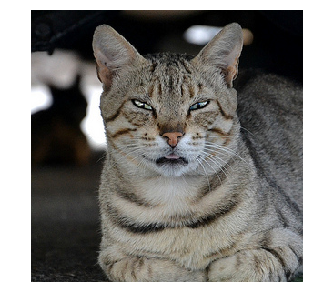

Probability 76.00% of [Egyptian cat]
Probability 11.42% of [tiger cat]
Probability 5.66% of [tabby, tabby cat]
Probability 0.38% of [lynx, catamount]
Probability 0.07% of [snow leopard, ounce, Panthera uncia]


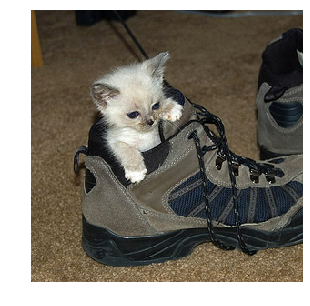

Probability 61.83% of [Persian cat]
Probability 12.27% of [running shoe]
Probability 1.29% of [shoe shop, shoe-shop, shoe store]
Probability 1.11% of [Shih-Tzu]
Probability 0.80% of [Pomeranian]


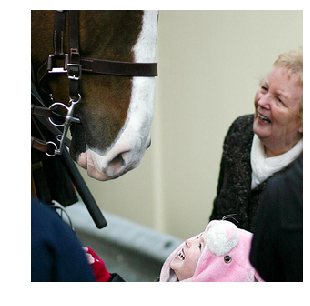

Probability 35.84% of [sorrel]
Probability 5.39% of [horse cart, horse-cart]
Probability 2.45% of [muzzle]
Probability 1.75% of [llama]
Probability 1.49% of [cowboy hat, ten-gallon hat]


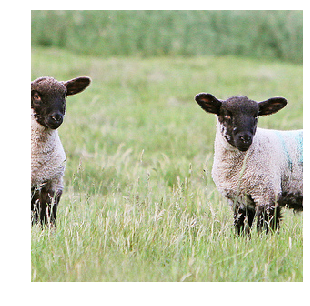

Probability 86.45% of [ram, tup]
Probability 1.59% of [bighorn, bighorn sheep, cimarron, Rocky Mountain bighorn, Rocky Mountain sheep, Ovis canadensis]
Probability 0.73% of [water buffalo, water ox, Asiatic buffalo, Bubalus bubalis]
Probability 0.50% of [warthog]
Probability 0.26% of [hog, pig, grunter, squealer, Sus scrofa]


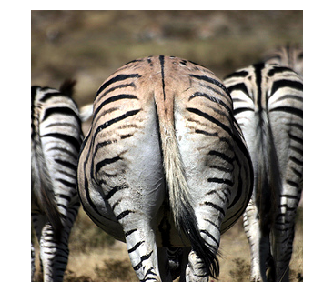

Probability 68.01% of [zebra]
Probability 5.29% of [tiger, Panthera tigris]
Probability 4.76% of [tiger cat]
Probability 0.49% of [impala, Aepyceros melampus]
Probability 0.23% of [ostrich, Struthio camelus]


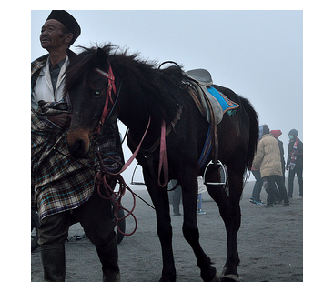

Probability 78.45% of [horse cart, horse-cart]
Probability 4.93% of [plow, plough]
Probability 0.93% of [military uniform]
Probability 0.36% of [bearskin, busby, shako]
Probability 0.36% of [cowboy hat, ten-gallon hat]


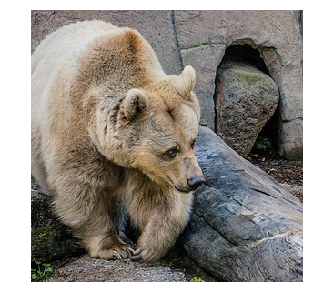

Probability 86.70% of [brown bear, bruin, Ursus arctos]
Probability 1.60% of [ice bear, polar bear, Ursus Maritimus, Thalarctos maritimus]
Probability 0.54% of [American black bear, black bear, Ursus americanus, Euarctos americanus]
Probability 0.31% of [sloth bear, Melursus ursinus, Ursus ursinus]
Probability 0.24% of [lion, king of beasts, Panthera leo]


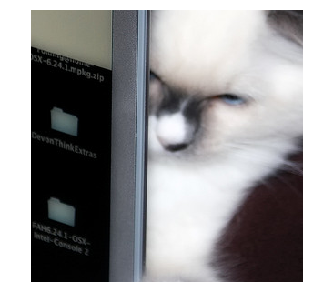

Probability 40.28% of [screen, CRT screen]
Probability 16.23% of [Persian cat]
Probability 11.21% of [monitor]
Probability 4.68% of [iPod]
Probability 3.10% of [television, television system]


In [85]:
disp(images_test, id2label=inet.id2label, probs=probs, scale=True)

##Image classification using retrained Inception v3 in TensorFlow
The retraining of Inception v3 differs from the VGG16, as we use the softmax activation
layer for the output with `tf.losses.softmax_cross_entropy()` as the loss function.

First define the placeholders,

In [0]:
tf.reset_default_graph()

In [0]:
is_training = tf.placeholder(tf.bool, name='is_training')
x_p = tf.placeholder(shape=(None, image_height, image_width, 3),
                     dtype=tf.float32,
                     name='x_p')
y_p = tf.placeholder(shape=(None, coco.n_classes),
                     dtype=tf.int32,
                     name='y_p')

Next, load the model,

In [0]:
with slim.arg_scope(inception.inception_v3_arg_scope()):
  logits,_ = inception.inception_v3(x_p,
                                    num_classes=coco.n_classes,
                                    is_training=True)
probabilities = tf.nn.softmax(logits)

Next, define functions to restore the variables except the last layer,

In [0]:
# restore except last layer
checkpoint_exclude_scopes=["InceptionV3/Logits", "InceptionV3/AuxLogits"]
exclusions = [scope.strip() for scope in checkpoint_exclude_scopes]

variables_to_restore = []
for var in slim.get_model_variables():
  excluded = False
  for exclusion in exclusions:
    if var.op.name.startswith(exclusion):
      excluded = True
      break
  if not excluded:
    variables_to_restore.append(var)

init_fn = slim.assign_from_checkpoint_fn(
                  os.path.join(model_home, '{}.ckpt'.format(model_name)),
                  variables_to_restore)

Define the loss, optimizer, and training operations,

In [0]:
tf.losses.softmax_cross_entropy(onehot_labels=y_p, logits=logits)
loss = tf.losses.get_total_loss()

In [0]:
learning_rate = 0.001
optimizer = tf.train.GradientDescentOptimizer(learning_rate = learning_rate)
train_op = optimizer.minimize(loss)

Train the model and run the prediction once the training is done in the same session,

In [0]:
n_epochs=10
coco.y_onehot = True
coco.batch_size = 32
coco.batch_shuffle = True
total_images = len(x_train_files)
n_batches = total_images // coco.batch_size

In [113]:
with tf.Session() as tfs:
  tfs.run(tf.global_variables_initializer())
  init_fn(tfs)  
        
  for epoch in range(n_epochs):
    print('Starting epoch ',epoch)
    coco.reset_index()
    epoch_accuracy=0
    epoch_loss=0
    for batch in range(n_batches):
      try:
        x_batch, y_batch = coco.next_batch()
        images=np.array([coco.preprocess_for_inception(x) for x in x_batch])
                    
        feed_dict = {x_p: images,y_p: y_batch,is_training: True}
        batch_loss,_ = tfs.run([loss,train_op], feed_dict = feed_dict)

        #feed_dict={x_p: images, y_p: y_onehot,is_training: False}
        #batch_accuracy = tfs.run(accuracy,feed_dict=feed_dict)
        epoch_loss += batch_loss 
        #epoch_accuracy += batch_accuracy
      except Exception as ex:
        print('error in epoch {} batch {}'.format(epoch,batch))
        print(ex)
  #epoch_accuracy /= n_batches
  epoch_loss /= n_batches
            
  print('Train loss in epoch {}:{}'.format(epoch,epoch_loss))
            
  # now run the predictions
  feed_dict={x_p:images_test,is_training: False}
  probs = tfs.run([probabilities],feed_dict=feed_dict)
  probs=probs[0]

INFO:tensorflow:Restoring parameters from /root/models/inception_v3/inception_v3.ckpt
Starting epoch  0
Starting epoch  1
Starting epoch  2
Starting epoch  3
Starting epoch  4
Starting epoch  5
Starting epoch  6
Starting epoch  7
Starting epoch  8
Starting epoch  9
Train loss in epoch 9:1.043250060081482


See the result,

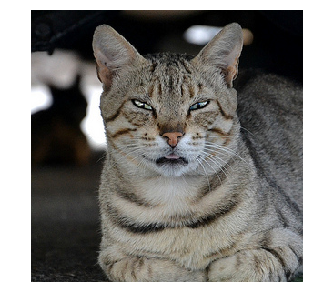

Probability 39.76% of [cat]
Probability 14.18% of [bird]
Probability 10.05% of [dog]
Probability 9.68% of [giraffe]
Probability 9.47% of [zebra]


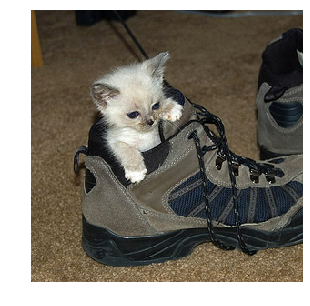

Probability 29.54% of [dog]
Probability 23.96% of [cat]
Probability 20.64% of [bird]
Probability 9.44% of [giraffe]
Probability 8.26% of [sheep]


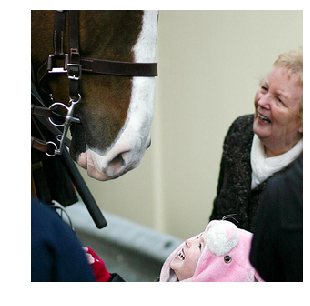

Probability 25.42% of [horse]
Probability 22.15% of [dog]
Probability 16.61% of [giraffe]
Probability 11.38% of [cat]
Probability 8.51% of [bird]


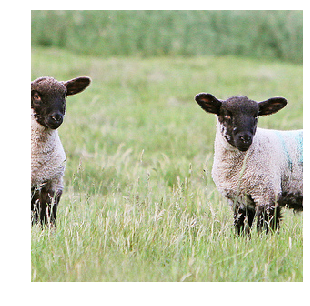

Probability 55.46% of [sheep]
Probability 9.08% of [bear]
Probability 8.50% of [cat]
Probability 7.97% of [giraffe]
Probability 6.96% of [horse]


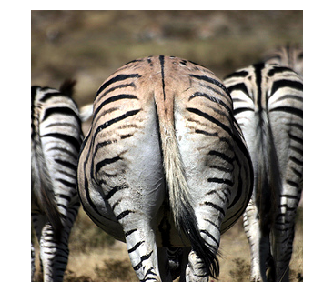

Probability 51.14% of [zebra]
Probability 19.70% of [giraffe]
Probability 8.85% of [bird]
Probability 6.71% of [sheep]
Probability 4.98% of [bear]


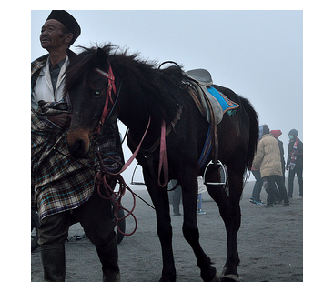

Probability 82.47% of [horse]
Probability 4.77% of [dog]
Probability 4.45% of [sheep]
Probability 2.57% of [bird]
Probability 2.49% of [giraffe]


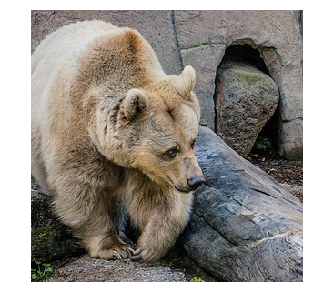

Probability 60.59% of [bear]
Probability 7.32% of [giraffe]
Probability 6.31% of [sheep]
Probability 6.27% of [zebra]
Probability 5.56% of [horse]


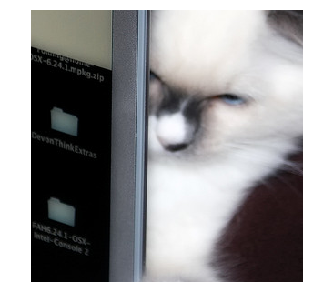

Probability 33.57% of [cat]
Probability 26.87% of [bird]
Probability 12.63% of [bear]
Probability 9.74% of [sheep]
Probability 7.90% of [dog]


In [114]:
disp(images_test,id2label=coco.id2label,probs=probs,scale=True)